## Setup

### Import libraries

In [1]:
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
import matplotlib.ticker as ticker

### Set library parameters

In [59]:
# Pandas display options
pd.set_option('display.max_columns', None)
pd.set_option('display.max_rows', None)
pd.set_option('display.max_colwidth', -1)

# Pandas + matplotlib
from pandas.plotting import register_matplotlib_converters
register_matplotlib_converters()

# Pyplot options
plt.rcParams.update({'font.size': 16, 'font.sans-serif': 'Arial'})

### Download raw SF 311 data
Data downloaded from https://data.sfgov.org/City-Infrastructure/311-Cases/vw6y-z8j6 on February 6, 2020

In [3]:
df = pd.read_csv('./data/311_Cases.csv')
df.head()

/Users/ihwang/anaconda3/lib/python3.7/site-packages/IPython/core/interactiveshell.py:3057: DtypeWarning: Columns (19) have mixed types. Specify dtype option on import or set low_memory=False.
  interactivity=interactivity, compiler=compiler, result=result)


,CaseID,Opened,Closed,Updated,Status,Status Notes,Responsible Agency,Category,Request Type,Request Details,Address,Street,Supervisor District,Neighborhood,Police District,Latitude,Longitude,Point,Source,Media URL,SF Find Neighborhoods,Current Police Districts,Current Supervisor Districts,Analysis Neighborhoods,:@computed_region_rxqg_mtj9,:@computed_region_yftq_j783,:@computed_region_jx4q_fizf,:@computed_region_bh8s_q3mv,:@computed_region_p5aj_wyqh,:@computed_region_fyvs_ahh9,:@computed_region_f58d_8dbm,:@computed_region_9dfj_4gjx,:@computed_region_vtsz_7cme,:@computed_region_n4xg_c4py,:@computed_region_sruu_94in,:@computed_region_4isq_27mq,:@computed_region_viu7_rrfi,:@computed_region_fcz8_est8,:@computed_region_pigm_ib2e,:@computed_region_9jxd_iqea,:@computed_region_6ezc_tdp2,:@computed_region_6pnf_4xz7,:@computed_region_h4ep_8xdi,:@computed_region_nqbw_i6c3,:@computed_region_2dwj_jsy4,:@computed_region_y6ts_4iup,Neighborhoods
0,929675,07/29/2011 09:16:17 AM,11/16/2009 09:25:00 AM,11/16/2009 09:25:00 AM,Closed,Case Resolved - Closed,DPW BSM Queue,Litter Receptacles,Cans_Left_Out_24x7,Cans_Left_Out_24x7,"478 28TH AVE, SAN FRANCISCO, CA, 94121",28TH AVE,1.0,Outer Richmond,RICHMOND,37.780376,-122.487923,"(37.78037643, -122.48792267)",Phone,NaN,8.0,8.0,4.0,29.0,2.0,11.0,9.0,55.0,6.0,26.0,26.0,NaN,8.0,NaN,4.0,NaN,NaN,NaN,NaN,NaN,NaN,2.0,NaN,NaN,NaN,NaN,8.0
1,572452,12/31/2009 05:42:50 PM,12/31/2009 07:16:33 PM,12/31/2009 07:16:33 PM,Closed,See Notes tab for more details,DPW Ops Queue,Street and Sidewalk Cleaning,Overflowing_City_Receptacle_or_Dumpster,Overflowing_City_Receptacle_or_Dumpster,Intersection of BACON ST and SAN BRUNO AVE,BACON ST,9.0,Portola,BAYVIEW,37.727634,-122.403595,"(37.72763443, -122.40359497)",Phone,NaN,91.0,2.0,2.0,25.0,7.0,10.0,3.0,309.0,3.0,28.0,28.0,NaN,91.0,NaN,2.0,NaN,NaN,NaN,NaN,NaN,NaN,2.0,NaN,NaN,NaN,NaN,91.0
2,572435,12/31/2009 04:56:54 PM,12/31/2009 06:16:31 PM,12/31/2009 06:16:31 PM,Closed,See Notes tab for more details,DPW Ops Queue,Street and Sidewalk Cleaning,Bulky Items,Electronics,Intersection of 27TH AVE and CLEMENT ST,27TH AVE,1.0,Outer Richmond,RICHMOND,37.781925,-122.487022,"(37.7819252, -122.4870224)",Phone,NaN,8.0,8.0,4.0,29.0,2.0,11.0,9.0,55.0,6.0,26.0,26.0,NaN,8.0,NaN,4.0,NaN,NaN,NaN,NaN,NaN,NaN,2.0,NaN,NaN,NaN,NaN,8.0
3,572432,12/31/2009 04:49:38 PM,12/31/2009 06:16:30 PM,12/31/2009 06:16:30 PM,Closed,See Notes tab for more details,DPW Ops Queue,Sewer Issues,Sewage_Back_Up,Outofsewervent4inch,"912 PERSIA AVE, SAN FRANCISCO, CA, 94112",PERSIA AVE,11.0,Excelsior,INGLESIDE,37.719467,-122.428566,"(37.71946716, -122.42856598)",Phone,NaN,90.0,9.0,1.0,7.0,6.0,9.0,4.0,28861.0,7.0,5.0,5.0,NaN,90.0,NaN,1.0,NaN,NaN,NaN,NaN,NaN,NaN,2.0,NaN,NaN,NaN,NaN,90.0
4,572429,12/31/2009 04:45:22 PM,12/31/2009 07:16:32 PM,12/31/2009 07:16:32 PM,Closed,See Notes tab for more details,DPW Ops Queue,Street and Sidewalk Cleaning,General Cleaning,Other Loose Garbage,Intersection of BOYLSTON ST and HALE ST,BOYLSTON ST,9.0,Portola,BAYVIEW,37.731480,-122.410759,"(37.73147964, -122.41075897)",Phone,NaN,91.0,2.0,2.0,25.0,7.0,9.0,3.0,309.0,3.0,28.0,28.0,NaN,91.0,NaN,2.0,NaN,NaN,NaN,NaN,NaN,NaN,2.0,NaN,NaN,NaN,NaN,91.0


## Explore data

### Slice and dice! Let's look at the data in different ways

In [18]:
# Print all columns names
print(df.columns)

# # Print all possible Request Types
# sorted(list(set(df['Request Type'])))

# Get all cases that have request details
# df_det = df[df['Request Details'].notnull()]

# # Which Request Types have Request Details containing a particular string, like 'homeless' or 'encampment'?
# df_det[df_det['Request Details'].str.contains('homeless', case=False)]['Request Type'].value_counts().head(10)

# # Get all cases that have request Status Notes
# df_notes = df[df['Status Notes'].notnull()]

# # Which Request Types have Status Notes containing a particular string, like 'homeless' or 'encampment'?
# df_notes[df_notes['Status Notes'].str.contains('encampment', case=False)]['Request Type'].value_counts().head(10)

Index(['CaseID', 'Opened', 'Closed', 'Updated', 'Status', 'Status Notes',
       'Responsible Agency', 'Category', 'Request Type', 'Request Details',
       'Address', 'Street', 'Supervisor District', 'Neighborhood',
       'Police District', 'Latitude', 'Longitude', 'Point', 'Source',
       'Media URL', 'SF Find Neighborhoods', 'Current Police Districts',
       'Current Supervisor Districts', 'Analysis Neighborhoods',
       ':@computed_region_rxqg_mtj9', ':@computed_region_yftq_j783',
       ':@computed_region_jx4q_fizf', ':@computed_region_bh8s_q3mv',
       ':@computed_region_p5aj_wyqh', ':@computed_region_fyvs_ahh9',
       ':@computed_region_f58d_8dbm', ':@computed_region_9dfj_4gjx',
       ':@computed_region_vtsz_7cme', ':@computed_region_n4xg_c4py',
       ':@computed_region_sruu_94in', ':@computed_region_4isq_27mq',
       ':@computed_region_viu7_rrfi', ':@computed_region_fcz8_est8',
       ':@computed_region_pigm_ib2e', ':@computed_region_9jxd_iqea',
       ':@computed_regi

## Story idea 1: all cases with the words 'encampment' in Status Notes or Request Details

Let's look at all cases that have the words 'encampment' in Status Notes or Request Details

In [107]:
df_e_nd = df[
    df['Status Notes'].str.contains('encampment', case=False) |
    df['Request Details'].str.contains('encampment', case=False)
].copy()
df_e_nd['Opened Year'] = pd.DatetimeIndex(df_e_nd['Opened']).year

In [108]:
top10_nbhrds = list(df_e_nd.groupby('Neighborhood')['CaseID'].count().sort_values(ascending=False).head(10).index)
df_top10_nbhrds = df_e_nd[df_e_nd['Neighborhood'].isin(top10_nbhrds)]

In [109]:
top10_nbhrds_trend = df_top10_nbhrds.groupby(['Neighborhood', 'Opened Year'])['Neighborhood'].count()
top10_nbhrds_trend

Neighborhood      Opened Year
Castro            2008           4    
                  2009           6    
                  2010           11   
                  2011           5    
                  2012           2    
                  2013           6    
                  2014           10   
                  2015           202  
                  2016           1360 
                  2017           1838 
                  2018           2339 
                  2019           3178 
                  2020           788  
Cathedral Hill    2008           8    
                  2009           25   
                  2010           39   
                  2011           55   
                  2012           33   
                  2013           33   
                  2014           67   
                  2015           83   
                  2016           213  
                  2017           1064 
                  2018           2094 
                  2019           3

In [110]:
top10_nbhrds_trend.unstack().transpose()

Neighborhood,Castro,Cathedral Hill,Duboce Triangle,Lower Nob Hill,Mission,Mission Dolores,Potrero Hill,Showplace Square,South of Market,Tenderloin
Opened Year,,,,,,,,,,
2008,4,8,4,14,38,13,11,4,49,1
2009,6,25,4,20,60,20,14,14,109,11
2010,11,39,5,28,56,19,8,27,85,7
2011,5,55,2,20,63,5,13,33,101,22
2012,2,33,5,24,68,10,7,15,147,28
2013,6,33,12,53,124,13,13,46,190,68
2014,10,67,30,24,399,41,43,40,244,44
2015,202,83,58,57,1171,125,134,214,1004,136
2016,1360,213,343,301,6514,727,1073,1392,5035,270


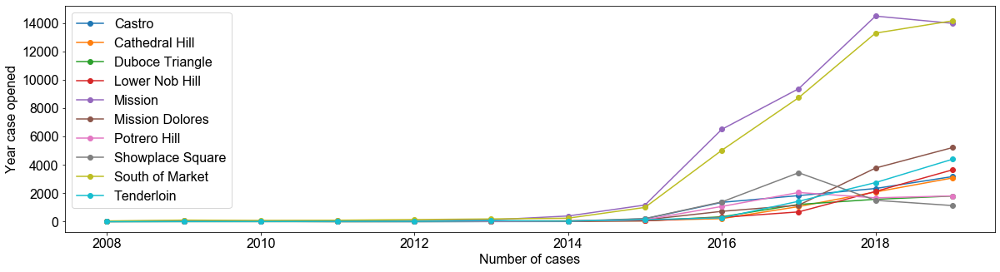

In [111]:
df_top10_yr = top10_nbhrds_trend.unstack().transpose()

# Define figure parameters
fsize=16
fig, axes = plt.subplots(figsize=(20, 5))

plt.plot(df_top10_yr[:-1], 'o-')
axes.set_ylabel('Year case opened')
axes.set_xlabel('Number of cases')
axes.legend(df_top10_yr.columns)
plt.show()

What the hell happened between 2015-2016?

In [116]:
df_e_nd[df_e_nd['Neighborhood'] == 'Mission' & df_e_nd['Opened Year'] == 2015]

,CaseID,Opened,Closed,Updated,Status,Status Notes,Responsible Agency,Category,Request Type,Request Details,Address,Street,Supervisor District,Neighborhood,Police District,Latitude,Longitude,Point,Source,Media URL,SF Find Neighborhoods,Current Police Districts,Current Supervisor Districts,Analysis Neighborhoods,:@computed_region_rxqg_mtj9,:@computed_region_yftq_j783,:@computed_region_jx4q_fizf,:@computed_region_bh8s_q3mv,:@computed_region_p5aj_wyqh,:@computed_region_fyvs_ahh9,:@computed_region_f58d_8dbm,:@computed_region_9dfj_4gjx,:@computed_region_vtsz_7cme,:@computed_region_n4xg_c4py,:@computed_region_sruu_94in,:@computed_region_4isq_27mq,:@computed_region_viu7_rrfi,:@computed_region_fcz8_est8,:@computed_region_pigm_ib2e,:@computed_region_9jxd_iqea,:@computed_region_6ezc_tdp2,:@computed_region_6pnf_4xz7,:@computed_region_h4ep_8xdi,:@computed_region_nqbw_i6c3,:@computed_region_2dwj_jsy4,:@computed_region_y6ts_4iup,Neighborhoods,Opened Year
381007,4887730,07/07/2015 10:52:55 AM,07/08/2015 02:24:09 PM,07/08/2015 02:24:09 PM,Closed,Case Completed - resolved: 10/98,DPW Ops Queue,Encampments,Encampment Reports,Encampment Cleanup,"10 CLEVELAND ST, SAN FRANCISCO, CA, 94103",CLEVELAND ST,6.0,South of Market,SOUTHERN,37.776935,-122.406714,"(37.77693481, -122.40671385)",Phone,NaN,32.0,1.0,10.0,34.0,9.0,14.0,2.0,28853.0,2.0,34.0,34.0,24.0,32.0,NaN,10.0,6.0,NaN,NaN,6.0,NaN,NaN,2.0,NaN,NaN,NaN,NaN,32.0,2015
381254,4886867,07/07/2015 07:41:15 AM,07/07/2015 07:45:25 AM,07/07/2015 07:45:25 AM,Closed,Case Completed - resolved: 10-98,DPW Ops Queue,Encampments,Encampment Reports,Encampment Cleanup,"284 LINDEN ST, SAN FRANCISCO, CA, 94102",LINDEN ST,5.0,Civic Center,NORTHERN,37.776558,-122.422653,"(37.77655792, -122.4226532)",Phone,NaN,21.0,4.0,11.0,9.0,11.0,7.0,6.0,28852.0,9.0,10.0,10.0,NaN,21.0,1.0,11.0,NaN,NaN,1.0,NaN,8.0,NaN,1.0,NaN,1.0,NaN,NaN,21.0,2015
381262,4886837,07/07/2015 07:29:34 AM,07/07/2015 07:39:00 AM,07/07/2015 07:39:00 AM,Closed,Case Completed - resolved:,DPW Ops Queue,Encampments,Encampment Reports,Encampment Cleanup,Intersection of CHARTER OAK AVE and AUGUSTA ST,CHARTER OAK AVE,10.0,Silver Terrace,BAYVIEW,37.734344,-122.404541,"(37.73434448, -122.40454102)",Web,NaN,87.0,2.0,9.0,1.0,8.0,10.0,3.0,58.0,3.0,1.0,1.0,NaN,87.0,NaN,9.0,NaN,NaN,NaN,NaN,NaN,NaN,2.0,NaN,NaN,NaN,NaN,87.0,2015
381513,4886159,07/06/2015 06:36:53 PM,07/13/2015 03:09:33 AM,07/13/2015 03:09:33 AM,Closed,Case Completed - resolved: 7/13/2015 Per Twinkle 311 This is on private property and should have never been sent to DPW…,DPW Ops Queue,Encampments,Encampment Reports,Encampment Cleanup,"1875 GEARY BLVD, SAN FRANCISCO, CA, 94115",GEARY BLVD,5.0,Western Addition,NORTHERN,37.783938,-122.434139,"(37.7839377, -122.4341394)",Phone,NaN,97.0,4.0,11.0,39.0,11.0,13.0,6.0,29490.0,9.0,41.0,41.0,NaN,97.0,NaN,11.0,NaN,NaN,NaN,NaN,NaN,NaN,2.0,NaN,NaN,NaN,NaN,97.0,2015
381877,4885005,07/06/2015 02:05:45 PM,07/07/2015 01:00:00 AM,07/07/2015 01:00:00 AM,Closed,Case Completed - resolved: done,DPW Ops Queue,Encampments,Encampment Reports,Encampment Cleanup,Intersection of GRAND VIEW AVE and 23RD ST,GRAND VIEW AVE,8.0,Upper Market,MISSION,37.752378,-122.442524,"(37.75237769, -122.4425239)",Phone,NaN,51.0,3.0,5.0,22.0,5.0,2.0,7.0,28862.0,4.0,22.0,22.0,NaN,51.0,NaN,5.0,NaN,NaN,NaN,NaN,NaN,NaN,1.0,NaN,NaN,NaN,NaN,51.0,2015
381885,4884961,07/06/2015 01:55:39 PM,07/07/2015 01:50:57 AM,07/07/2015 01:50:57 AM,Closed,Case Completed - resolved: 1098,DPW Ops Queue,Encampments,Encampment Reports,Encampment Cleanup,"90 WOODLAND AVE, SAN FRANCISCO, CA, 94117",WOODLAND AVE,5.0,Parnassus Heights,PARK,37.762465,-122.452992,"(37.76246452, -122.45299155)",Phone,NaN,110.0,7.0,11.0,14.0,11.0,15.0,8.0,29492.0,5.0,12.0,12.0,NaN,110.0,NaN,11.0,NaN,NaN,NaN,NaN,NaN,NaN,1.0,NaN,NaN,NaN,NaN,110.0,2015
381904,4884894,07/06/2015 01:45:19 PM,07/07/2015 02:32:43 PM,07/07/2015 02:32:43 PM,Closed,Case Completed - resolved: 10-98,DPW Ops Queue,Encampments,Encampment Reports,Encampment Cleanup,Intersection of 5TH S

UPDATE: Okay so actually that's only 29 requests, not that much -- nothing to see here, moving on.

Noticed that a lot of the cases in the Mission had Status Notes that said something along the line of "Not a valid 311 request. For active encampments, dial non-emergency SFPD." So let's filter for the cases that have the word 'encampment' and 'non-emergency SFPD' in the Status Notes.

In [133]:
df_e_nd_invalid = df_e_nd[
    df_e_nd['Status Notes'].str.contains('encampment', case=False) &
    df_e_nd['Status Notes'].str.contains('non-emergency SFPD', case=False)
]
print('Number of cases with "encampment" and "non-emergency SFPD" in the Status Notes: ', len(df_e_nd_invalid))
df_e_nd_invalid.head()

Number of cases with "encampment" and "non-emergency SFPD" in the Status Notes:  29


,CaseID,Opened,Closed,Updated,Status,Status Notes,Responsible Agency,Category,Request Type,Request Details,Address,Street,Supervisor District,Neighborhood,Police District,Latitude,Longitude,Point,Source,Media URL,SF Find Neighborhoods,Current Police Districts,Current Supervisor Districts,Analysis Neighborhoods,:@computed_region_rxqg_mtj9,:@computed_region_yftq_j783,:@computed_region_jx4q_fizf,:@computed_region_bh8s_q3mv,:@computed_region_p5aj_wyqh,:@computed_region_fyvs_ahh9,:@computed_region_f58d_8dbm,:@computed_region_9dfj_4gjx,:@computed_region_vtsz_7cme,:@computed_region_n4xg_c4py,:@computed_region_sruu_94in,:@computed_region_4isq_27mq,:@computed_region_viu7_rrfi,:@computed_region_fcz8_est8,:@computed_region_pigm_ib2e,:@computed_region_9jxd_iqea,:@computed_region_6ezc_tdp2,:@computed_region_6pnf_4xz7,:@computed_region_h4ep_8xdi,:@computed_region_nqbw_i6c3,:@computed_region_2dwj_jsy4,:@computed_region_y6ts_4iup,Neighborhoods,Opened Year
771645,4845997,06/22/2015 02:08:36 PM,06/22/2015 03:27:59 PM,06/22/2015 03:27:59 PM,Closed,"Case Resolved - Not a valid 311 request. For active encampments, dial non-emergency SFPD at 415-553-0123.",311 Supervisor Queue,Encampments,Encampment items,Cart Pickup,Intersection of ENTERPRISE ST and FOLSOM ST,ENTERPRISE ST,9.0,Mission,MISSION,37.764305,-122.415304,"(37.76430489, -122.41530433)",Mobile/Open311,NaN,53.0,3.0,2.0,20.0,7.0,8.0,7.0,28859.0,4.0,19.0,19.0,12.0,53.0,NaN,2.0,14.0,NaN,3.0,14.0,NaN,NaN,2.0,NaN,3.0,NaN,NaN,53.0,2015
772054,4844865,06/22/2015 08:51:16 AM,06/22/2015 11:47:00 AM,06/22/2015 11:47:00 AM,Closed,"Case Resolved - Not a valid 311 service request. For active encampments, please call non-emergency SFPD at 415-553-0123 when in progress.",311 Supervisor Queue,Blocked Street or SideWalk,Blocked_Sidewalk,Residential_totter blocking sidewalk,"648 STANYAN ST, SAN FRANCISCO, CA, 94117",STANYAN ST,5.0,Haight Ashbury,PARK,37.770142,-122.453255,"(37.770142, -122.453255)",Mobile/Open311,NaN,25.0,7.0,11.0,3.0,11.0,15.0,8.0,29492.0,5.0,9.0,9.0,22.0,25.0,NaN,11.0,24.0,NaN,NaN,25.0,NaN,NaN,1.0,NaN,NaN,NaN,NaN,25.0,2015
781294,4818174,06/10/2015 07:10:28 PM,06/11/2015 10:42:49 AM,06/11/2015 10:42:49 AM,Closed,"Case Resolved - Not a valid 311 service request. For active encampments including the belongings of the persons, please call non-emergency SFPD at 415-553-0123. If abandoned debris remains, your service request should fall under the category 'street and sidewalk cleaning'",311 Supervisor Queue,Blocked Street or SideWalk,Blocked_Sidewalk,Residential_totter blocking sidewalk,"177 VALENCIA ST, SAN FRANCISCO, CA, 94103",VALENCIA ST,9.0,South of Market,SOUTHERN,37.770432,-122.422386,"(37.77043152, -122.42238617)",Mobile/Open311,http://mobile311.sfgov.org/reports/4818174/photos,32.0,1.0,2.0,20.0,7.0,8.0,2.0,28853.0,2.0,19.0,19.0,NaN,32.0,NaN,2.0,NaN,NaN,NaN,NaN,NaN,NaN,2.0,NaN,NaN,NaN,NaN,32.0,2015
782241,4785190,05/29/2015 02:21:39 PM,05/29/2015 03:53:01 PM,05/29/2015 03:53:01 PM,Closed,"Case Resolved - For active/occupied encampments, 311 cannot process a request. Customer please call non-emergency SFPD at 415-553-0123. Thank you.",311 Supervisor Queue,Blocked Street or SideWalk,Blocked_Sidewalk,Residential_totter blocking sidewalk,Intersection of 4TH ST and PERRY ST,4TH ST,6.0,South of Market,SOUTHERN,37.780303,-122.399169,"(37.7803027, -122.3991687)",Mobile/Open311,http://mobile311.sfgov.org/reports/4785190/photos,32.0,1.0,10.0,34.0,9.0,6.0,2.0,28856.0,2.0,34.0,34.0,NaN,32.0,NaN,10.0,NaN,NaN,NaN,NaN,NaN,NaN,2.0,NaN,NaN,NaN,NaN,32.0,2015
782608,4783859,05/28/2015 10:38:13 PM,05/29/2015 03:24:01 PM,05/29/2015 03:24:01 PM,Closed,"Case Resolved - Cannot confirm if this is an active encampment or not. Customer please call non-emergency SFPD at 415-553-0123 if the encampent is active/occupied. If reporting abandoned items on the sidewalk, please specify in a new request, or call 311 to make the report. Thank you.",311 Supervisor Queue,General Request - PUBLIC WORKS,complaint,bsm - complai

What about 'Illegal_Encampment' in 'Request Details?'

In [134]:
len(df[df['Request Details'] == 'Illegal_Encampment'])

953

## Story idea 2: all cases that are Request Type 'Add_remove_garbage_can' 

Select cases for 'Add_remove_garbage_can'

In [6]:
# Select certain columns
select_columns = [
    'CaseID', 'Opened', 'Closed', 'Updated', 'Status', 'Status Notes',
    'Responsible Agency', 'Category', 'Request Type', 'Request Details',
    'Address', 'Street', 'Supervisor District', 'Neighborhood',
    'Police District', 'Latitude', 'Longitude', 'Point', 'Source',
    'Media URL', 'SF Find Neighborhoods', 'Current Police Districts',
    'Current Supervisor Districts', 'Analysis Neighborhoods'
]
df_garbage = df.loc[df['Request Type'] == 'Add_remove_garbage_can', select_columns]

# Convert datetime columns to datetime objects
datetime_cols = ['Opened','Closed','Updated']
df_garbage[datetime_cols] = df_garbage[datetime_cols].apply(pd.to_datetime)

# Preview dataframe
# df_garbage.head(3)

Explore garbage requests

In [7]:
# Explore Request details
df_gd = df_garbage.loc[df_garbage['Request Details'].notnull()]
print('Number of garbage add/remove requests with request details: ', len(df_gd))

# Find earliest and latest garbage requests
print('Oldest garbage add/remove request: ', df_garbage['Opened'].min())
print('Most recent garbage add/remove request: ', df_garbage['Opened'].max())

# How many garbage add/remove cases mentioned encampments in their status notes?
df_ge = df_garbage[df_garbage['Status Notes'].str.contains('encampment', case=False)]
print('Number of garbage add/remove cases mentioning "encampment" in status notes: ', len(df_ge))

# How many garbage add/remove cases mentioned homeless in their status notes?
df_gh = df_garbage[df_garbage['Status Notes'].str.contains('homeless', case=False)]
print('Number of garbage add/remove cases mentioning "homeless" in status notes: ', len(df_gh))

# How many garbage add/remove cases mentioned either encampments or homeless in their status notes?
df_ghe = df_garbage[df_garbage['Status Notes'].str.contains('homeless', case=False) | df_garbage['Status Notes'].str.contains('encampment', case=False)]
print('Number of garbage add/remove cases mentioning "homeless" or "encampment" in status notes: ', len(df_ghe))

Number of garbage add/remove requests with request details:  0
Oldest garbage add/remove request:  2015-02-12 17:13:36
Most recent garbage add/remove request:  2020-02-05 17:30:00
Number of garbage add/remove cases mentioning "encampment" in status notes:  12
Number of garbage add/remove cases mentioning "homeless" in status notes:  39
Number of garbage add/remove cases mentioning "homeless" or "encampment" in status notes:  48


Digging into cases mentioning "homeless" in status notes

In [8]:
# Sort by most recent to oldest case
df_ghe.sort_values('Opened', ascending=False)
# df_gh.head(3)

,CaseID,Opened,Closed,Updated,Status,Status Notes,Responsible Agency,Category,Request Type,Request Details,Address,Street,Supervisor District,Neighborhood,Police District,Latitude,Longitude,Point,Source,Media URL,SF Find Neighborhoods,Current Police Districts,Current Supervisor Districts,Analysis Neighborhoods
119677,11960772,2020-01-18 09:11:00,2020-01-21 09:07:17,2020-01-21 09:07:17,Closed,Case Resolved - Pickup completed HOMELESS OCCUPIED,Recology_Litter,Litter Receptacles,Add_remove_garbage_can,NaN,Intersection of ELLIS ST and MASON ST,ELLIS ST,3.0,Tenderloin,TENDERLOIN,37.785213,-122.409522,"(37.78521258, -122.40952212)",Mobile/Open311,http://mobile311.sfgov.org/reports/11960772/photos,20.0,5.0,10.0,36.0
93835,11955769,2020-01-17 08:03:00,2020-01-20 12:18:23,2020-01-20 12:18:23,Closed,Case Resolved - Pickup completed HOMELESS OCCUPIED,Recology_Litter,Litter Receptacles,Add_remove_garbage_can,NaN,Intersection of ELLIS ST and MASON ST,ELLIS ST,3.0,Tenderloin,TENDERLOIN,37.785227,-122.409548,"(37.785227, -122.40954793)",Mobile/Open311,http://mobile311.sfgov.org/reports/11955769/photos,20.0,5.0,10.0,36.0
156869,11936712,2020-01-13 08:48:00,2020-01-14 12:20:08,2020-01-14 12:20:08,Closed,Case Resolved - Pickup completed HOMELESS OCCUPIED,Recology_Litter,Litter Receptacles,Add_remove_garbage_can,NaN,"163 FREELON ST, SAN FRANCISCO, CA, 94107",FREELON ST,6.0,South of Market,SOUTHERN,37.777783,-122.398250,"(37.7777832, -122.3982505)",Mobile/Open311,http://mobile311.sfgov.org/reports/11936712/photos,32.0,1.0,10.0,34.0
35436,11920768,2020-01-09 10:23:00,2020-01-10 15:48:33,2020-01-10 15:48:33,Closed,Case Resolved - Pickup completed HOMELESS OCCUPIED,Recology_Litter,Litter Receptacles,Add_remove_garbage_can,NaN,"501 EDDY ST, SAN FRANCISCO, CA, 94109",EDDY ST,6.0,Tenderloin,TENDERLOIN,37.783351,-122.415904,"(37.78335144, -122.41590394)",Mobile/Open311,http://mobile311.sfgov.org/reports/11920768/photos,20.0,5.0,10.0,36.0
1902,11911044,2020-01-07 10:21:00,2020-01-09 21:35:41,2020-01-09 21:35:41,Closed,Encampment Removed,Duplicate Case Hold Queue,Litter Receptacles,Add_remove_garbage_can,NaN,Intersection of VAN NESS AVE and BUSH ST,VAN NESS AVE,3.0,Cathedral Hill,NORTHERN,37.788375,-122.422068,"(37.78837545, -122.42206815)",Mobile/Open311,NaN,100.0,4.0,6.0,39.0
3071735,11708506,2019-11-19 10:34:00,2019-11-20 09:37:39,2019-11-20 09:37:39,Closed,Case Resolved - Pickup completed HOMELESS OCCUPIED,Recology_Litter,Litter Receptacles,Add_remove_garbage_can,NaN,Intersection of EDDY ST and LEAVENWORTH ST,EDDY ST,6.0,Tenderloin,TENDERLOIN,37.783778,-122.414227,"(37.78377787, -122.41422689)",Mobile/Open311,http://mobile311.sfgov.org/reports/11708506/photos,20.0,5.0,10.0,36.0
3116998,11603266,2019-10-25 21:33:00,2019-10-26 12:30:39,2019-10-26 12:30:39,Closed,Case is Invalid - Requests related to the concern or well-being of individuals not in an encampment are not handled by 311.,HSOC Individual Queue,Litter Receptacles,Add_remove_garbage_can,NaN,"1620 WEBSTER ST, SAN FRANCISCO, CA, 94115",WEBSTER ST,5.0,Japantown,NORTHERN,37.785500,-122.431204,"(37.78549972, -122.43120351)",Mobile/Open311,http://mobile311.sfgov.org/reports/11603266/photos,101.0,4.0,11.0,15.0
3162547,11498207,2019-10-03 08:01:00,2019-10-03 09:00:05,2019-10-03 09:00:05,Closed,Case is Invalid - Requests related to the concern or well-being of individuals not in an encampment are not handled by 311.,HSOC Individual Queue,Litter Receptacles,Add_remove_garbage_can,NaN,"475 VAN NESS AVE, SAN FRANCISCO, CA, 94102",VAN NESS AVE,5.0,Civic Center,NORTHERN,37.779700,-122.420000,"(37.7797, -122.42)",Mobile/Open311,http://mobile311.sfgov.org/reports/11498207/photos,21.0,4.0,10.0,36.0
4030169,11423119,2019-09-16 12:56:00,2019-09-17 16:03:15,2019-09-17 16:03:15,Closed,Case Resolved - Pickup completed HOMELESS OCCUPIED,Recology_Litter,Litter Receptacles,Add_remove_garbage_can,NaN,"1850 MISSION ST, SAN FRANCISCO, CA, 94103",MISSION ST,9.0,Mission,MISSION,37.767443,-122.419906,"(37.76744313, -122.419

Let's see what these cases look like over time

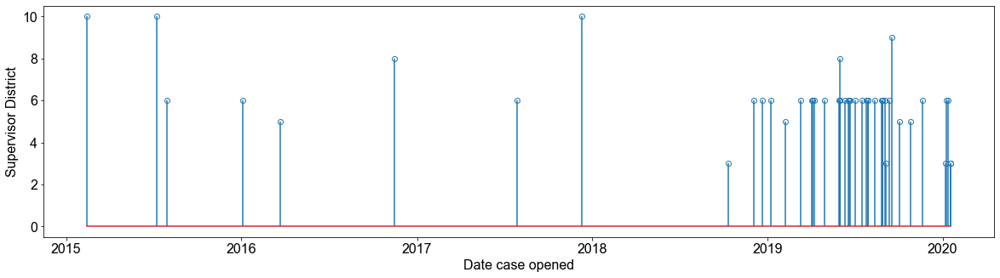

In [9]:
df_gh_plot = df_ghe.copy()

# Define figure parameters
fsize=16
fig, axes = plt.subplots(figsize=(20, 5))

df_gh_plot.set_index('Opened', inplace=True)
markerline, stemlines, baseline = plt.stem(df_gh_plot.index, df_ghe['Supervisor District'],
                                           use_line_collection=True
                                          )
markerline.set_markerfacecolor('none')
axes.set_ylabel('Supervisor District')
axes.set_xlabel('Date case opened')
plt.show()

## Story idea 3: Look at the different media that are being submitted

In [104]:
df[df['Media URL'].notnull()]['Request Type'].value_counts()

General Cleaning                                      208879
Bulky Items                                           162498
Encampment Reports                                    109507
Human or Animal Waste                                 58079 
Abandoned Vehicles                                    34813 
Graffiti on Building_commercial                       32927 
request_for_service                                   32890 
Graffiti on Other_enter_additional_details_below      31592 
City_garbage_can_overflowing                          26521 
Graffiti on Pole                                      25258 
Graffiti on Sidewalk_in_front_of_property             22479 
Illegal Postings - Affixed_Improperly                 22449 
Medical Waste                                         20202 
Graffiti on Signal_box                                17822 
Parking_on_Sidewalk                                   17585 
Sign - Defaced                                        17386 
Graffiti on Mail_box    